In [1]:
import numpy as np
import pandas as pd
import requests
import io

url = "https://raw.githubusercontent.com/ageron/handson-ml/master/datasets/housing/housing.csv"
tdf = pd.read_csv(url)
tdf.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [2]:
df = tdf.query('ocean_proximity == "NEAR BAY"')

In [3]:
X = df['median_income'].values
y = df['median_house_value'].values

# Normalize target for easier learning
y = y / 1000  # convert to thousands
print("X shape:", X.shape)
print("y shape:", y.shape)

X shape: (2290,)
y shape: (2290,)


In [4]:
# np.random.seed(42)
rng = np.random.default_rng(42)
indices = rng.permutation(len(X))
train_size = int(0.8 * len(X))

print(indices)
print(train_size)  

[1816 1778  967 ... 1572 1633 1672]
1832


In [5]:

print("indices unique:", np.unique(indices).shape == indices.shape)
print("indices min/max:", np.min(indices), np.max(indices))

train_idx, test_idx = indices[:train_size], indices[train_size:]
X_train, X_test = X[train_idx], X[test_idx]
y_train, y_test = y[train_idx], y[test_idx]

print("train_idx shape:", train_idx.shape)
print("test_idx shape:", test_idx.shape)
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)


indices unique: True
indices min/max: 0 2289
train_idx shape: (1832,)
test_idx shape: (458,)
X_train shape: (1832,)
X_test shape: (458,)
y_train shape: (1832,)
y_test shape: (458,)


In [6]:
# Add bias term (column of 1s)
X_train_bias = np.c_[np.ones((X_train.shape[0], 1)), X_train]
X_test_bias = np.c_[np.ones((X_test.shape[0], 1)), X_test]

print(X_train_bias.shape)
print(X_train_bias)

(1832, 2)
[[1.     3.6667]
 [1.     1.9464]
 [1.     3.6449]
 ...
 [1.     1.8068]
 [1.     3.5625]
 [1.     7.611 ]]


In [7]:
# Train using Normal Equation
# β = (XᵀX)⁻¹ Xᵀy

theta_best = np.linalg.inv(X_train_bias.T.dot(X_train_bias)).dot(X_train_bias.T).dot(y_train)

print("Model parameters (bias, slope):", theta_best)

Model parameters (bias, slope): [96.64417232 38.63945966]


In [8]:
y_pred = X_test_bias.dot(theta_best)
errors = y_test - y_pred

mae = np.mean(np.abs(errors))   # Mean Absolute Error
mape = np.mean(np.abs(errors / y_test)) * 100      # Mean Absolute Percentage Error
max_error_pct = np.max(np.abs(errors / y_test)) * 100
min_error_pct = np.min(np.abs(errors / y_test)) * 100

print(errors.shape)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.2f}%")
print(f"Max % Error: {max_error_pct:.2f}%")
print(f"Min % Error: {min_error_pct:.2f}%")

(458,)
MAE: 75.2482
MAPE: 33.96%
Max % Error: 213.52%
Min % Error: 0.01%


In [9]:
# Evaluation Root Mean Squared Error (RMSE)

rmse = np.sqrt(np.mean((y_pred - y_test) ** 2))
print("RMSE:", rmse, "thousand dollars")

RMSE: 97.98844497211232 thousand dollars


In [10]:
# Custom prediction

custom_income = 8.0  # median income = $80,000
custom_input = np.array([[1, custom_income]])  # bias + feature
predicted_price = custom_input.dot(theta_best)[0]
print(f"Predicted house value for income ${custom_income*1000:.0f}: ${predicted_price*1000:.2f}")

Predicted house value for income $8000: $405759.85


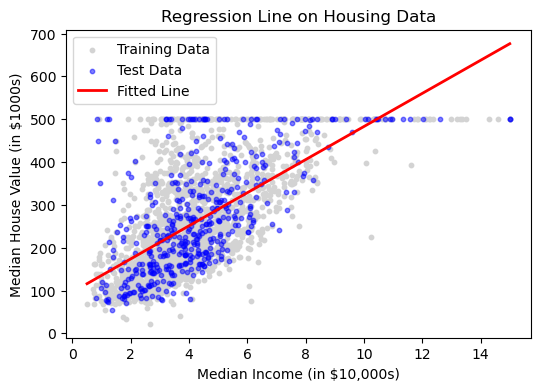

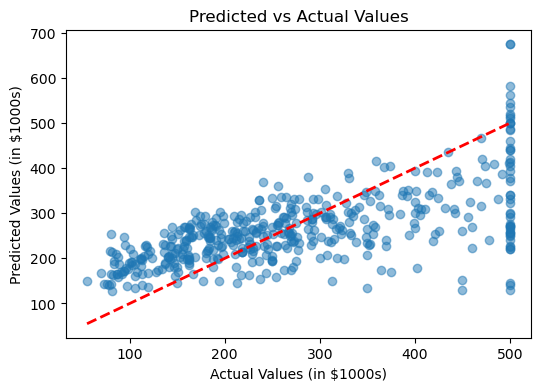

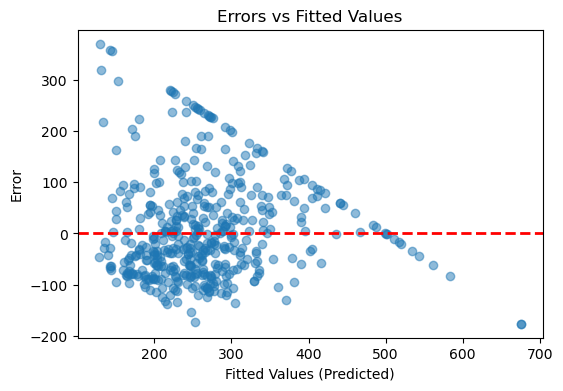

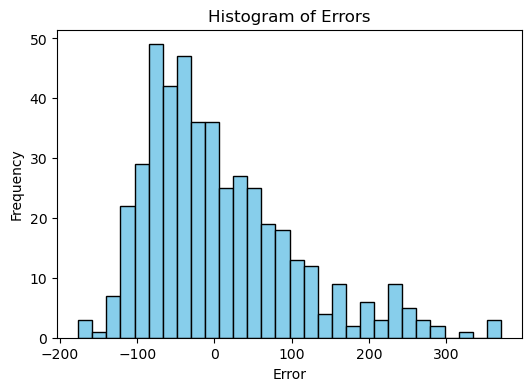

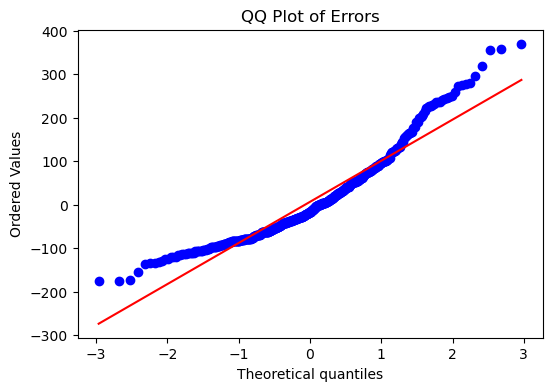

In [11]:
import matplotlib.pyplot as plt
from scipy import stats

# Scatter Plot with Regression Line

plt.figure(figsize=(6, 4))
plt.scatter(X_train, y_train, color="lightgray", s=10, label="Training Data")
plt.scatter(X_test, y_test, color="blue", s=10, alpha=0.5, label="Test Data")

x_line = np.linspace(X.min(), X.max(), 100)
y_line = theta_best[0] + theta_best[1] * x_line
plt.plot(x_line, y_line, color="red", linewidth=2, label="Fitted Line")

plt.xlabel("Median Income (in $10,000s)")
plt.ylabel("Median House Value (in $1000s)")
plt.title("Regression Line on Housing Data")
plt.legend()
plt.show()


# Predicted vs Actual

plt.figure(figsize=(6, 4))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.plot([y_test.min(), y_test.max()],
         [y_test.min(), y_test.max()],
         color="red", linestyle="--", linewidth=2)
plt.xlabel("Actual Values (in $1000s)")
plt.ylabel("Predicted Values (in $1000s)")
plt.title("Predicted vs Actual Values")
plt.show()


# Errors vs Fitted

plt.figure(figsize=(6, 4))
plt.scatter(y_pred, errors, alpha=0.5)
plt.axhline(y=0, color="red", linestyle="--", linewidth=2)
plt.xlabel("Fitted Values (Predicted)")
plt.ylabel("Error")
plt.title("Errors vs Fitted Values")
plt.show()


# Histogram of Errors

plt.figure(figsize=(6, 4))
plt.hist(errors, bins=30, color="skyblue", edgecolor="black")
plt.xlabel("Error")
plt.ylabel("Frequency")
plt.title("Histogram of Errors")
plt.show()


# QQ Plot of Errors

plt.figure(figsize=(6, 4))
stats.probplot(errors, dist="norm", plot=plt)
plt.title("QQ Plot of Errors")
plt.show()

Final m: 38.55075741906957, Final b: 98.3427726359729
MAE: 74.3054
MSE: 9032.3165
RMSE: 95.0385
MAPE: 35.90%


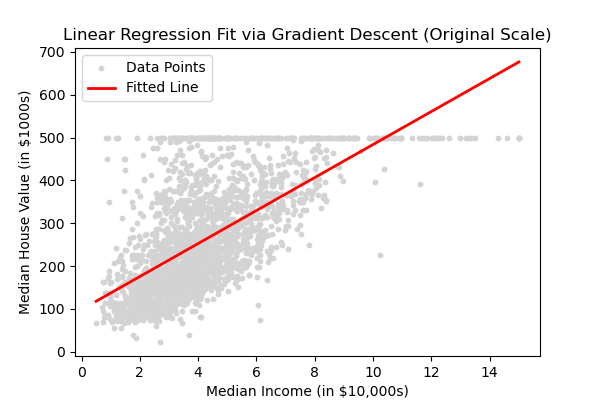

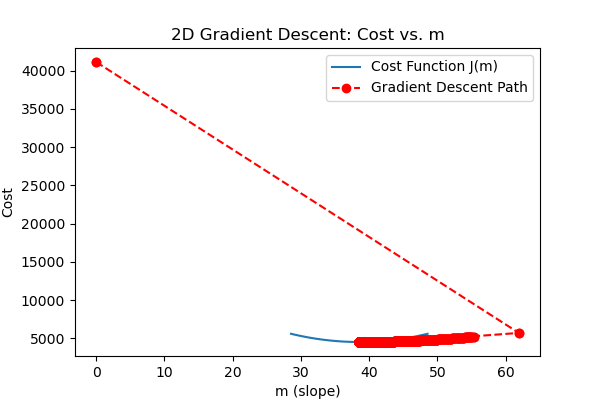

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
(50, 50)
-6.656144159854381
[[-10.          -8.32807208  -6.65614416 ...  68.58061224  70.25254016
   71.92446808]
 [-10.          -8.32807208  -6.65614416 ...  68.58061224  70.25254016
   71.92446808]
 [-10.          -8.32807208  -6.65614416 ...  68.58061224  70.25254016
   71.92446808]
 ...
 [-10.          -8.32807208  -6.65614416 ...  68.58061224  70.25254016
   71.92446808]
 [-10.          -8.32807208  -6.65614416 ...  68.58061224  70.25254016
   71.92446808]
 [-10.          -8.32807208  -6.65614416 ...  68.58061224  70.25254016
   71.92446808]]
(50, 50)


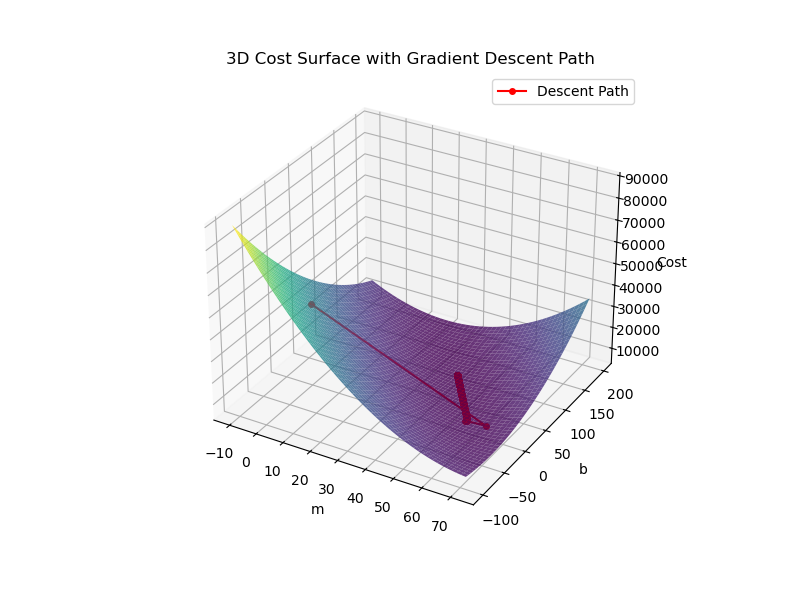

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# flatten X and y for 1D operations for mistakes like putting double brackets and thus making the data shape different
X1d = X.ravel()
y1d = y.ravel()

# Cost function on original scale
def compute_cost(X, y, m, b):
    predictions = m * X + b
    errors = predictions - y
    return np.mean(errors ** 2) / 2

# Gradient Descent on original scale
m, b = 0.0, 0.0
learning_rate = .05   
iterations = 1000

m_history = [m]
b_history = [b]
cost_history = [compute_cost(X1d, y1d, m, b)]

for _ in range(iterations):
    predictions = m * X1d + b
    error = predictions - y1d
    m_gradient = np.mean(error * X1d)
    b_gradient = np.mean(error)
    m -= learning_rate * m_gradient
    b -= learning_rate * b_gradient

    m_history.append(m)
    b_history.append(b)
    cost_history.append(compute_cost(X1d, y1d, m, b))

print(f"Final m: {m}, Final b: {b}")


# Predictions & Error Stats

y_pred = m * X1d + b
errors = y1d - y_pred
mae = np.mean(np.abs(errors))
mse = np.mean(errors ** 2)
rmse = np.sqrt(mse)
mape = np.mean(np.abs(errors / y1d)) * 100

print(f"MAE: {mae:.4f}")
print(f"MSE: {mse:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"MAPE: {mape:.2f}%")


# Plot fitted line

plt.figure(figsize=(6, 4))
plt.scatter(X1d, y1d, color="lightgray", s=10, label="Data Points")

x_line = np.linspace(X1d.min(), X1d.max(), 100)
y_line = m * x_line + b
plt.plot(x_line, y_line, color="red", linewidth=2, label="Fitted Line")

plt.xlabel("Median Income (in $10,000s)")
plt.ylabel("Median House Value (in $1000s)")
plt.title("Linear Regression Fit via Gradient Descent (Original Scale)")
plt.legend()
plt.show()


# 2D Cost vs m (b fixed)

m_values = np.linspace(m - 10, m + 10, 100)
cost_values = [compute_cost(X1d, y1d, m_val, b) for m_val in m_values]

plt.figure(figsize=(6, 4))
plt.plot(m_values, cost_values, label="Cost Function J(m)")
plt.scatter(m_history, cost_history, color="red", zorder=5)
plt.plot(m_history, cost_history, "ro--", label="Gradient Descent Path")
plt.xlabel("m (slope)")
plt.ylabel("Cost")
plt.title("2D Gradient Descent: Cost vs. m")
plt.legend()
plt.show()


# 3D Surface: Cost vs m & b

%matplotlib widget

m_grid = np.linspace(min(m_history) - 10, max(m_history) + 10, 50)
b_grid = np.linspace(min(b_history) - 100, max(b_history) + 100, 50)
M, B = np.meshgrid(m_grid, b_grid)

Z = np.zeros_like(M)
for i in range(M.shape[0]):
    for j in range(M.shape[1]):
        Z[i, j] = compute_cost(X1d, y1d, M[i, j], B[i, j])


fig3d = plt.figure(figsize=(8, 6))
ax3d = fig3d.add_subplot(111, projection='3d')
ax3d.plot_surface(M, B, Z, cmap='viridis', alpha=0.8)
ax3d.plot(m_history, b_history, cost_history, color="red", marker="o", markersize=4, label="Descent Path")
ax3d.set_xlabel("m")
ax3d.set_ylabel("b")
ax3d.set_zlabel("Cost")
ax3d.set_title("3D Cost Surface with Gradient Descent Path")
ax3d.legend()
plt.show()

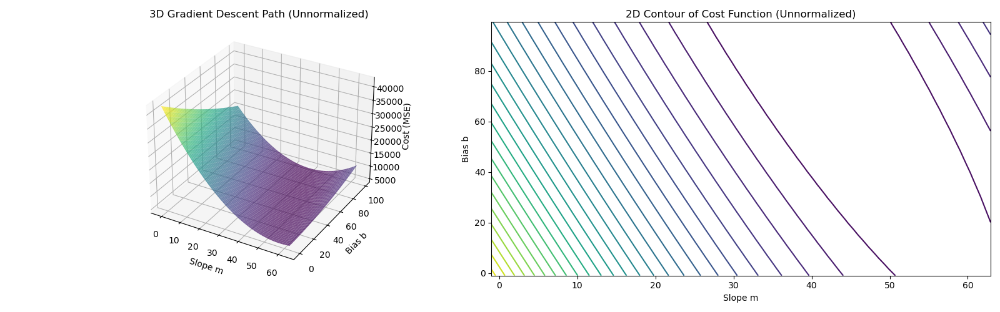

In [20]:
%matplotlib widget
from matplotlib import cm
import matplotlib.animation as animation

plt.close('all')    # Protection against ghost of previous 3D plots

# Prepare cost surface grid (unnormalized) 
m_vals = np.linspace(min(m_history)-1, max(m_history)+1, 50)
b_vals = np.linspace(min(b_history)-1, max(b_history)+1, 50)
M_grid, B_grid = np.meshgrid(m_vals, b_vals)

Z_grid = np.zeros_like(M_grid)
for i in range(M_grid.shape[0]):
    for j in range(M_grid.shape[1]):
        Z_grid[i, j] = compute_cost(X1d, y1d, M_grid[i, j], B_grid[i, j])

# Create figure with two subplots 
fig_dyn = plt.figure(figsize=(16, 5))

# 3D Surface
ax1 = fig_dyn.add_subplot(1, 2, 1, projection='3d')
surf = ax1.plot_surface(M_grid, B_grid, Z_grid, cmap=cm.viridis, alpha=0.7)
ax1.set_xlabel('Slope m')
ax1.set_ylabel('Bias b')
ax1.set_zlabel('Cost (MSE)')
ax1.set_title('3D Gradient Descent Path (Unnormalized)')
path3d, = ax1.plot([], [], [], 'r*-', markersize=5)

# 2D Contour
ax2 = fig_dyn.add_subplot(1, 2, 2)
contour = ax2.contour(M_grid, B_grid, Z_grid, levels=30, cmap=cm.viridis)
ax2.set_xlabel('Slope m')
ax2.set_ylabel('Bias b')
ax2.set_title('2D Contour of Cost Function (Unnormalized)')
path2d, = ax2.plot([], [], 'r*-', markersize=5)

# Animation update function
def update(frame):
    path3d.set_data(m_history[:frame], b_history[:frame])
    path3d.set_3d_properties(cost_history[:frame])
    path2d.set_data(m_history[:frame], b_history[:frame])
    return path3d, path2d

# Animate
ani = animation.FuncAnimation(
    fig_dyn, update, frames=len(m_history), 
    interval=200, blit=True, repeat=True
)

plt.tight_layout()
plt.show()

In [15]:
%matplotlib inline

from IPython.display import HTML

# flatten X and y for 1D operations
X1d = X.ravel()
y1d = y.ravel()

fig, ax = plt.subplots(figsize=(6, 4))
ax.scatter(X1d, y1d, color="lightgray", s=10)
line, = ax.plot([], [], color="red", linewidth=2)

# Set axis labels and title for clarity
ax.set_xlabel("Median Income (in $10,000s)")
ax.set_ylabel("Median House Value (in $1000s)")
ax.set_title("Dynamic Linear Regression Fit (Gradient Descent)")

trained_on_normalized = False  # Set to False for unnormalized gradient descent

def init():
    line.set_data([], [])
    return line,

def update(frame):
    # For unnormalized version, use m_history and b_history directly
    m_frame = m_history[frame]
    b_frame = b_history[frame]
    x_vals = np.linspace(X1d.min(), X1d.max(), 100)
    y_vals = m_frame * x_vals + b_frame
    line.set_data(x_vals, y_vals)
    return line,

ani = animation.FuncAnimation(
    fig, update, frames=len(m_history),
    init_func=init, interval=100, blit=False
)

plt.close(fig)  # Prevent static plot output in Jupyter
HTML(ani.to_jshtml())

Animation size has reached 21027182 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Final normalized m: 0.6331861959401013, Final normalized b: 5.585052071476767e-17, Final cost: 0.2995235666610639
Un-normalized m: 38.54761167405161, Un-normalized b: 98.35757050807817
MAE: 74.3062
MSE: 9032.3164
RMSE: 95.0385
MAPE: 35.91%


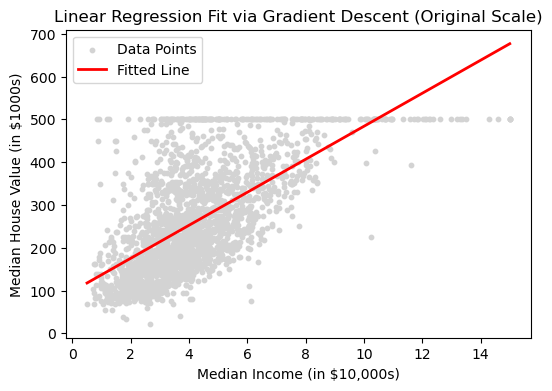

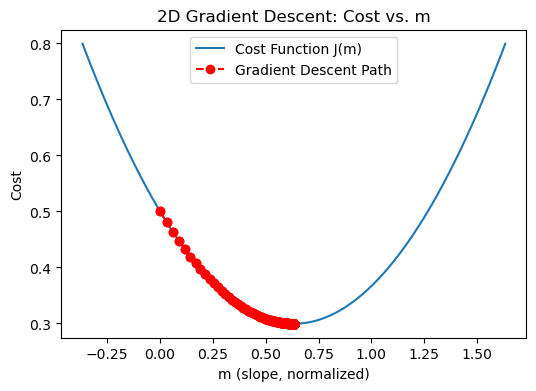

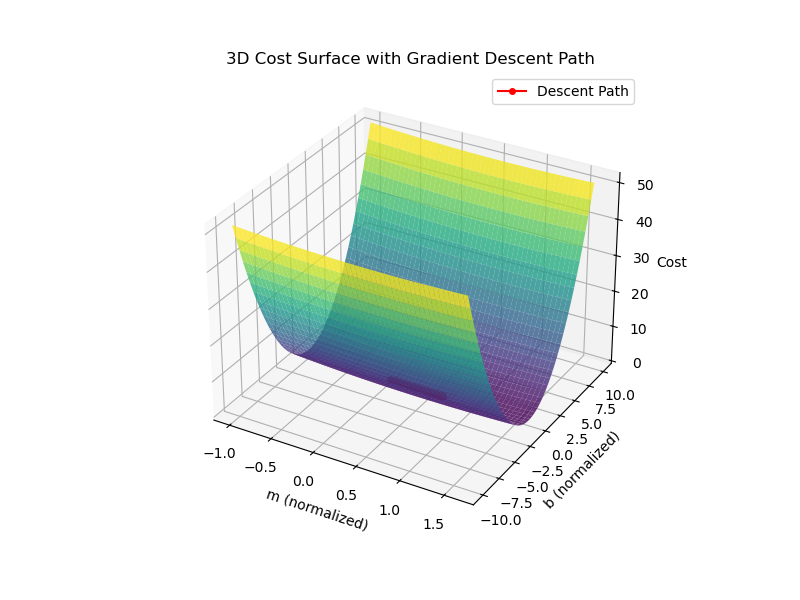

In [16]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

plt.close('all')    # Protection against ghost of previous 3D plots

# flatten X and y for 1D operations for mistakes like putting double brackets and thus making the data shape different
X1d = X.ravel()
y1d = y.ravel()

# Normalize feature for faster gradient descent convergence
X_mean, X_std = X1d.mean(), X1d.std()
y_mean, y_std = y1d.mean(), y1d.std()

Xn = (X1d - X_mean) / X_std
yn = (y1d - y_mean) / y_std

# Cost Function
def compute_cost(Xn, y, m, b):
    predictions = m * Xn + b
    errors = predictions - y
    return np.mean(errors**2) / 2

# Gradient Descent
m, b = 0.0, 0.0
learning_rate = .05
iterations = 200

m_history = [m]
b_history = [b]
cost_history = [compute_cost(Xn, yn, m, b)]

for _ in range(iterations):
    predictions = m * Xn + b
    error = predictions - yn
    m_gradient = np.mean(error * Xn)
    b_gradient = np.mean(error)
    m -= learning_rate * m_gradient
    b -= learning_rate * b_gradient
    
    m_history.append(m)
    b_history.append(b)
    cost_history.append(compute_cost(Xn, yn, m, b))

print(f"Final normalized m: {m}, Final normalized b: {b}, Final cost: {cost_history[-1]}")

# Convert to original scale 
m_orig = (m * y_std) / X_std
b_orig = y_mean + y_std * (b - m * X_mean / X_std)

print(f"Un-normalized m: {m_orig}, Un-normalized b: {b_orig}")

# Predictions and error statistics
y_pred = m_orig * X1d + b_orig
errors = y1d - y_pred
mae = np.mean(np.abs(errors))   # Mean Absolute Error
mse = np.mean(errors**2)    # Mean Squared Error
rmse = np.sqrt(mse)   # Root Mean Squared Error
mape = np.mean(np.abs(errors / y1d)) * 100    # Mean Absolute Percentage Error

print(f"MAE: {mae:.4f}")
print(f"MSE: {mse:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"MAPE: {mape:.2f}%")

# Plot fitted line on original data 
plt.figure(figsize=(6, 4))
plt.scatter(X1d, y1d, color="lightgray", s=10, label="Data Points")

# Predicted line (original scale)
x_line_orig = np.linspace(X1d.min(), X1d.max(), 100)
y_line_orig = m_orig * x_line_orig + b_orig
plt.plot(x_line_orig, y_line_orig, color="red", linewidth=2, label="Fitted Line")

plt.xlabel("Median Income (in $10,000s)")
plt.ylabel("Median House Value (in $1000s)")
plt.title("Linear Regression Fit via Gradient Descent (Original Scale)")
plt.legend()
plt.show()

# 2D Cost vs m (b fixed at final value)
m_values = np.linspace(m - 1, m + 1, 100)
cost_values = [compute_cost(Xn, yn, m_val, b) for m_val in m_values]

plt.figure(figsize=(6, 4))
plt.plot(m_values, cost_values, label="Cost Function J(m)")
plt.scatter(m_history, cost_history, color="red", zorder=5)
plt.plot(m_history, cost_history, "ro--", label="Gradient Descent Path")
plt.xlabel("m (slope, normalized)")
plt.ylabel("Cost")
plt.title("2D Gradient Descent: Cost vs. m")
plt.legend()
plt.show()

# 3D Surface: Cost vs m & b

%matplotlib widget

m_grid = np.linspace(min(m_history)-1, max(m_history)+1, 50)
b_grid = np.linspace(min(b_history)-10, max(b_history)+10, 50)
M, B = np.meshgrid(m_grid, b_grid)

Z = np.zeros_like(M)
for i in range(M.shape[0]):
    for j in range(M.shape[1]):
        Z[i, j] = compute_cost(Xn, yn, M[i, j], B[i, j])

fig3d = plt.figure(figsize=(8, 6))
ax3d = fig3d.add_subplot(111, projection='3d')
ax3d.plot_surface(M, B, Z, cmap='viridis', alpha=0.8)
ax3d.plot(m_history, b_history, cost_history, color="red", marker="o", markersize=4, label="Descent Path")
ax3d.set_xlabel("m (normalized)")
ax3d.set_ylabel("b (normalized)")
ax3d.set_zlabel("Cost")
ax3d.set_title("3D Cost Surface with Gradient Descent Path")
ax3d.legend()
plt.show()

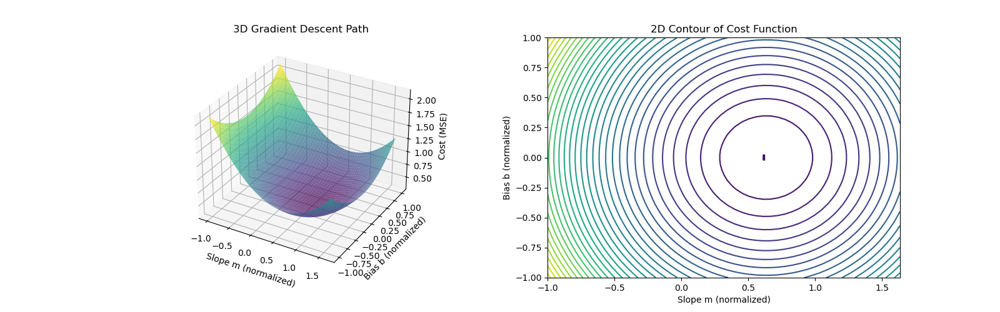

In [17]:
%matplotlib widget
from matplotlib import cm

plt.close('all')    # Protection against ghost of previous 3D plots

# Prepare cost surface grid 
m_vals = np.linspace(min(m_history)-1, max(m_history)+1, 50)
b_vals = np.linspace(min(b_history)-1, max(b_history)+1, 50)
M_grid, B_grid = np.meshgrid(m_vals, b_vals)

Z_grid = np.zeros_like(M_grid)
for i in range(M_grid.shape[0]):
    for j in range(M_grid.shape[1]):
        Z_grid[i, j] = compute_cost(Xn, yn, M_grid[i, j], B_grid[i, j])

# Create figure with two subplots 
fig_dyn = plt.figure(figsize=(16, 5))

# 3D Surface
ax1 = fig_dyn.add_subplot(1, 2, 1, projection='3d')
surf = ax1.plot_surface(M_grid, B_grid, Z_grid, cmap=cm.viridis, alpha=0.7)
ax1.set_xlabel('Slope m (normalized)')
ax1.set_ylabel('Bias b (normalized)')
ax1.set_zlabel('Cost (MSE)')
ax1.set_title('3D Gradient Descent Path')
path3d, = ax1.plot([], [], [], 'r*-', markersize=5)

# 2D Contour
ax2 = fig_dyn.add_subplot(1, 2, 2)
contour = ax2.contour(M_grid, B_grid, Z_grid, levels=30, cmap=cm.viridis)
ax2.set_xlabel('Slope m (normalized)')
ax2.set_ylabel('Bias b (normalized)')
ax2.set_title('2D Contour of Cost Function')
path2d, = ax2.plot([], [], 'r*-', markersize=5)

# Animation update function 
def update(frame):
    path3d.set_data(m_history[:frame], b_history[:frame])
    path3d.set_3d_properties(cost_history[:frame])
    path2d.set_data(m_history[:frame], b_history[:frame])
    return path3d, path2d

# Animate
ani = animation.FuncAnimation(
    fig_dyn, update, frames=len(m_history), 
    interval=200, blit=True, repeat=True
)


plt.show()

In [ ]:
%matplotlib inline

import matplotlib.animation as animation
from IPython.display import HTML

# flatten X and y for 1D operations
X1d = X.ravel()
y1d = y.ravel()

fig, ax = plt.subplots(figsize=(6, 4))
ax.scatter(X1d, y1d, color="lightgray", s=10)
line, = ax.plot([], [], color="red", linewidth=2)

# Set axis labels and title for clarity
ax.set_xlabel("Median Income (in $10,000s)")
ax.set_ylabel("Median House Value (in $1000s)")
ax.set_title("Dynamic Linear Regression Fit (Gradient Descent)")

trained_on_normalized = True  # Set to False if using unnormalized gradient descent

def init():
    line.set_data([], [])
    return line,

def update(frame):
    if trained_on_normalized:
        m_frame = (m_history[frame] * y_std) / X_std
        b_frame = y_mean + y_std * (b_history[frame] - m_history[frame] * X_mean / X_std)
    else:
        m_frame = m_history[frame]
        b_frame = b_history[frame]
    x_vals = np.linspace(X1d.min(), X1d.max(), 100)
    y_vals = m_frame * x_vals + b_frame
    line.set_data(x_vals, y_vals)
    return line,

ani = animation.FuncAnimation(
    fig, update, frames=len(m_history),
    init_func=init, interval=100, blit=False
)

plt.close(fig)  # Prevent static plot output in Jupyter
HTML(ani.to_jshtml())

In [ ]:
from sklearn.linear_model import LinearRegression

lr = LinearRegression()
lr.fit(X.reshape(-1, 1), y)
print("Sklearn m, b:", lr.coef_[0], lr.intercept_)

Sklearn m, b: 38.548962917982976 98.35193192287016
